# Project 05: Uber Pickups
## Bloc n°3 - Jedha - dsmft - Paris14
### Nicolas Hegerle

## Library imports and function definition

### <ins>Imoprt the necessary libraries and functions for the project</ins>

In [1]:
import pandas as pd
import numpy as np
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)
pd.options.mode.chained_assignment = None

import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import plotly.io as pio
from plotly.subplots import make_subplots
pio.renderers.default = "vscode"
from IPython.display import display, clear_output

# mapbox token required for using mapbox with plotly graph object
import private
mapbox_access_token = private.mapbox_access_token

from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics import silhouette_score, davies_bouldin_score
from sklearn.neighbors import NearestNeighbors

from math import *
import os
import shutil

# defined functions are in a seperate file
from graph_func import *

## Part I: data loading and exploration

### <ins>Load dataset and print basic statistics</ins>

In [2]:
df_maysep14 = pd.read_csv("uber-trip-data/uber-raw-data-maysep14.csv", parse_dates=[0])

In [3]:
#Display some information about the dataset
print('Shape of the dataframe for 2014 data is:', df_maysep14.shape)

print('\nSome info about the datasets for 2014 data:\n')
print(df_maysep14.info())
print('\nDescription of the data in the dataframe for 2014:\n')
display(df_maysep14.describe(include = 'all', datetime_is_numeric=True))

Shape of the dataframe for 2014 data is: (4534327, 4)

Some info about the datasets for 2014 data:

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4534327 entries, 0 to 4534326
Data columns (total 4 columns):
 #   Column     Dtype         
---  ------     -----         
 0   Date/Time  datetime64[ns]
 1   Lat        float64       
 2   Lon        float64       
 3   Base       object        
dtypes: datetime64[ns](1), float64(2), object(1)
memory usage: 138.4+ MB
None

Description of the data in the dataframe for 2014:



,Date/Time,Lat,Lon,Base
count,4534327,4.534327e+06,4.534327e+06,4534327
unique,NaN,NaN,NaN,5
top,NaN,NaN,NaN,B02617
freq,NaN,NaN,NaN,1458853
mean,2014-07-11 18:50:50.578151424,4.073926e+01,-7.397302e+01,NaN
min,2014-04-01 00:00:00,3.965690e+01,-7.492900e+01,NaN
25%,2014-05-28 15:18:00,4.072110e+01,-7.399650e+01,NaN
50%,2014-07-17 14:45:00,4.074220e+01,-7.398340e+01,NaN
75%,2014-08-27 21:55:00,4.076100e+01,-7.396530e+01,NaN
max,2014-09-30 22:59:00,4.211660e+01,-7.206660e+01,NaN


<font size = 5>
- Quite a big dataset with 4,534,327 rows.<br>
- No missing values <br>
- df contains Lat and Lon of Uber pick ups with the date and time of the pickup and the initial base of the Uber <br>

In [4]:
#Create new columns containing the hour, minutes, dayofmonth, doyofweek and month for each pickup (month will be added to the data for 2014)
#Create new columns usefull for the analysis
df_maysep14.loc[ :, 'hour'] = pd.to_numeric(df_maysep14['Date/Time'].apply(lambda x : x.strftime("%H")))
df_maysep14.loc[:,'minutes'] = pd.to_numeric(df_maysep14['Date/Time'].apply(lambda x : x.strftime("%M")))
df_maysep14.loc[:, 'timeofday'] = df_maysep14['hour'] + df_maysep14['minutes'] / 60
df_maysep14.loc[ :, 'dayofweek'] = df_maysep14['Date/Time'].apply(lambda x: x.strftime("%A"))
df_maysep14.loc[ :, 'dayofmonth'] = df_maysep14['Date/Time'].apply(lambda x: x.strftime("%-d"))
df_maysep14.loc[ :, 'month'] = df_maysep14['Date/Time'].apply(lambda x: x.strftime("%B"))

display(df_maysep14.head())

,Date/Time,Lat,Lon,Base,hour,minutes,timeofday,dayofweek,dayofmonth,month
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,0,11,0.183333,Tuesday,1,April
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,0,17,0.283333,Tuesday,1,April
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,0,21,0.350000,Tuesday,1,April
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,0,28,0.466667,Tuesday,1,April
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,0,33,0.550000,Tuesday,1,April


### <ins>Exploratory Data Analysis</ins>

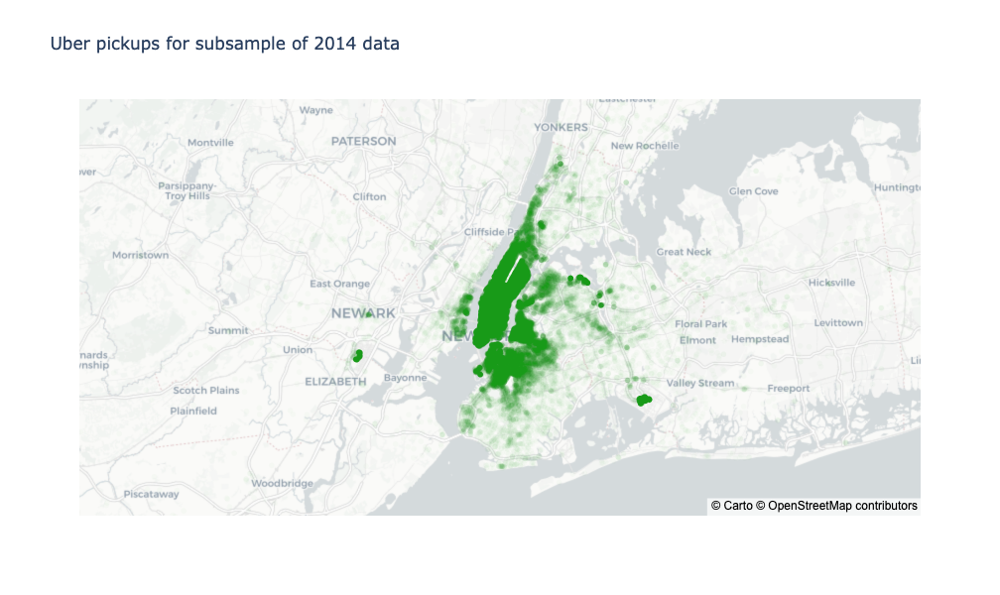

In [5]:
#The dataset is too big to plot all the locations with plotly so we drop duplicate lines and subsample the dataframe
df_subspl = df_maysep14.drop_duplicates().sample(200000) 
df_subspl = df_subspl.sort_values(by = 'hour')
fig = px.scatter_mapbox(df_subspl, lat = 'Lat', lon = 'Lon', \
                        mapbox_style='carto-positron', \
                        opacity = 0.02, color_discrete_sequence=['green'], \
                        width=900, height=600, zoom = 9, \
                        title = 'Uber pickups for subsample of 2014 data', 
                        center = {'lat' : df_subspl['Lat'].median(), 'lon' : df_subspl['Lon'].median()}
                       )
fig.show()

<font size = 5>
- The data represent Uber pickups in New-York city<br>
- There seems to be places with higher densities of Uber pickups than others around manhattan

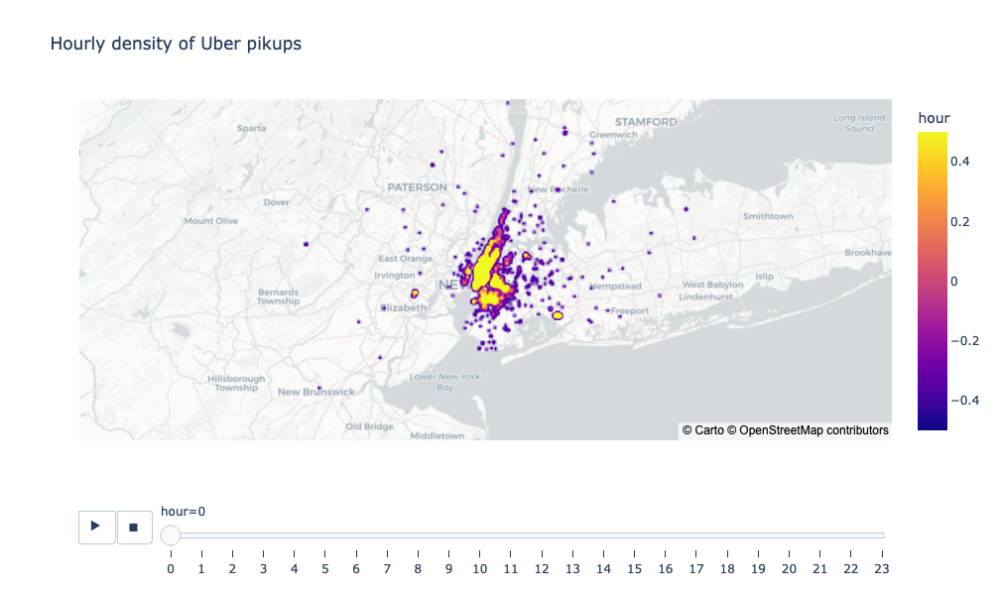

In [6]:
#Lets see the evolution over the hour of day
df_subspl = df_subspl.sort_values(by = 'hour')
fig = px.density_mapbox(df_subspl, lat = 'Lat', lon = 'Lon', z = 'hour', radius = 3, \
                        mapbox_style='carto-positron', \
                        animation_frame = "hour", \
                        width=900, height=600, \
                        title = 'Hourly density of Uber pikups', 
                        center = {'lat' : df_subspl['Lat'].median(), 'lon' : df_subspl['Lon'].median()}
                       )
fig.show()

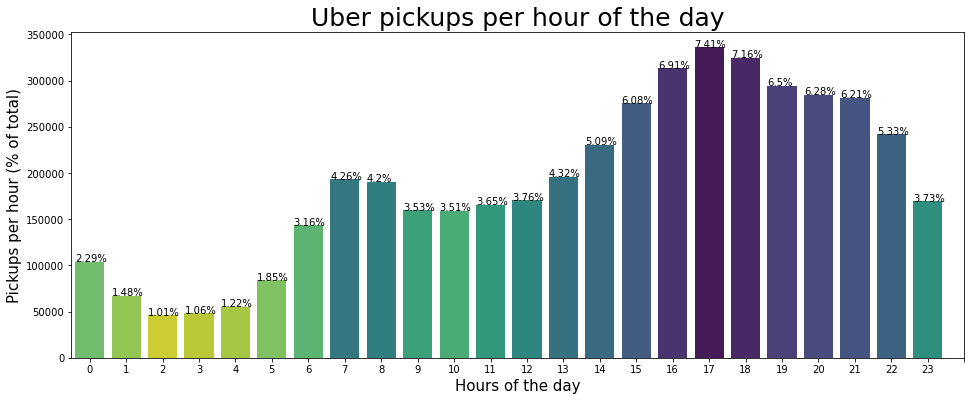

In [7]:
# plot density of uber pick ups per hour of the day for all pick-ups
rank = df_maysep14['hour'].value_counts(normalize = True).index.argsort() #rank the hours by most pickups per day
palette = sns.color_palette("viridis", len(df_maysep14['hour'].unique())) #generette a colour palette of the length of the data


plt.figure(figsize=(16, 6))
ax = sns.countplot(x = df_maysep14['hour'], palette = np.array(palette[::1])[rank]) #use the rank of the hours to assign a colour to the bar
ax.set_title('Uber pickups per hour of the day', fontsize = 25)
ax.set_xlabel('Hours of the day', fontsize = 15)
ax.set_ylabel('Pickups per hour (% of total)', fontsize = 15)
ax.set_xticks([i for i in range(25)])

for p in ax.patches:
        ax.annotate('{}%'.format(round((p.get_height()/df_maysep14.shape[0]*100), 2)), (p.get_x(), p.get_height()))

plt.show()


<font size = 5>
- Two 'spikes' during the day. One around 7-8 am and the other between 4 and 6pm.<br>
- Is there any daily trend over the week?



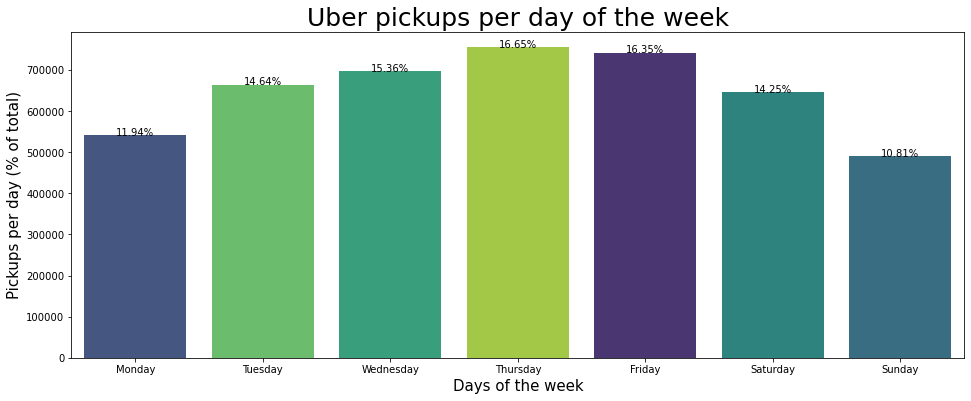

In [8]:
# plot the daily proportion of pick-ups for all pick-ups
palette = sns.color_palette("viridis", len(df_maysep14['dayofweek'].unique()))
rank = df_maysep14['dayofweek'].value_counts(normalize = True).index.argsort()
day_order = ["Monday","Tuesday","Wednesday","Thursday","Friday","Saturday","Sunday"]

plt.figure(figsize=(16, 6))
ax = sns.countplot(x = df_maysep14['dayofweek'], palette = np.array(palette[::1])[rank], order = day_order)
ax.set_title('Uber pickups per day of the week', fontsize = 25)
ax.set_xlabel('Days of the week', fontsize = 15)
ax.set_ylabel('Pickups per day (% of total)', fontsize = 15)

for p in ax.patches:
        ax.annotate('{}%'.format(round((p.get_height()/df_maysep14.shape[0]*100), 2)), (p.get_x()+0.25, p.get_height()))

plt.show()

<font size = 5>
- Thursday and Friday are the busiest days of the week<br>
- Monday and Sunday are the slowest

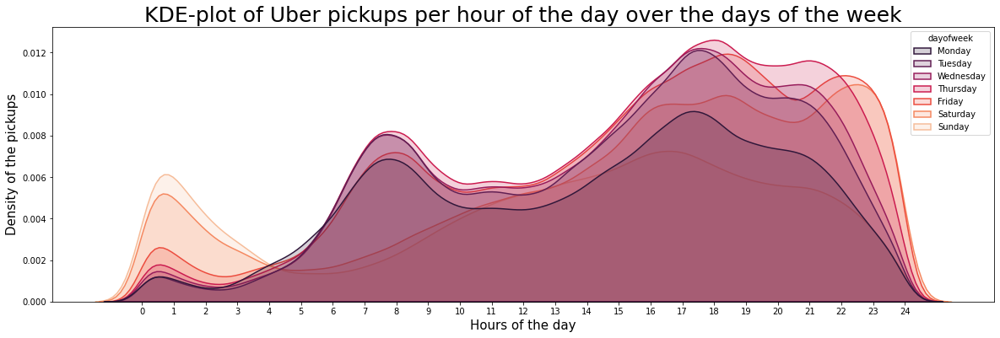

In [9]:
# lets see th hourly pick ups per day of week

plt.figure(figsize=(20, 6))

ax = sns.kdeplot(data = df_maysep14, x = 'timeofday', hue = 'dayofweek', hue_order=day_order, palette = 'rocket', alpha = 0.2, linewidth = 1.5, fill = True)
ax.set_title('KDE-plot of Uber pickups per hour of the day over the days of the week', fontsize = 25)
ax.set_xlabel('Hours of the day', fontsize = 15)
ax.set_ylabel('Density of the pickups', fontsize = 15)
ax.set_xticks([i for i in range(25)])

plt.show()

<font size = 5>
- Monday through Friday have specific trends of pickups over the time of day with spikes around 7am to 8am and between 4pm and 6pm<br>
- Saturday and Sunday have spikes around midnight / 1am => probably people going out Friday and Saturday night to party

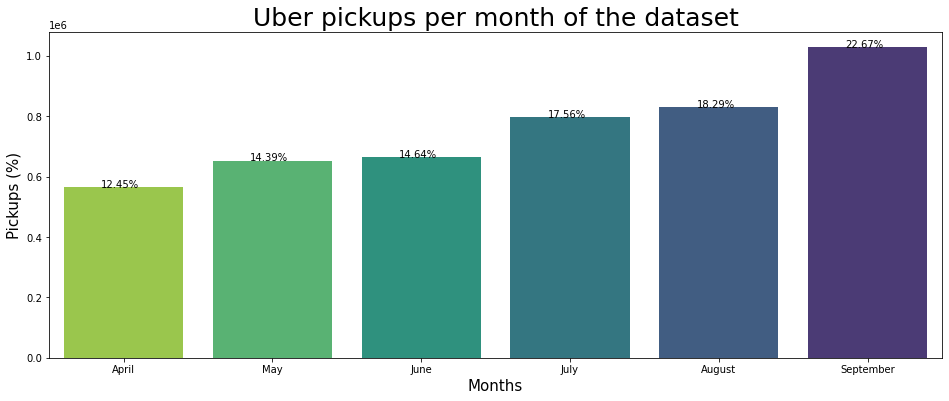

In [10]:
# is there a trend in uber pick-ups over the months

plt.figure(figsize=(16, 6))
ax = sns.countplot(x = df_maysep14['month'], palette = 'viridis_r')
ax.set_title('Uber pickups per month of the dataset', fontsize = 25)
ax.set_xlabel('Months', fontsize = 15)
ax.set_ylabel('Pickups (%)', fontsize = 15)

for p in ax.patches:
        ax.annotate('{}%'.format(round((p.get_height()/df_maysep14.shape[0]*100), 2)), (p.get_x()+0.25, p.get_height()))

plt.show()

<font size = 5>
- September counted for the most pickups for those data in 2014 with more than 20% of all pickups occuring during that month



<font size = 5>
- Based on the data available Uber pickups are influenced by the time of day, the day of week and the month of the year for 2014<br>
- There are pick-up 'hot-spots' in Manhattan and surroundings (Brooklyn, Williamsburg, Jersey city) and around the three major airports.<br>
<br>
Lets see if clustering brings some information by first focusing on April 28th 2014 between 6pm and 7pm

## Part II: clustering on partial data. Thursdays in April between 6pm and 7pm

### <ins>Subselecting the selected data</ins>

In [11]:
# subselect the dataframe for April

mask = df_maysep14['month'] == 'April'
df_apr_2014 = df_maysep14.loc[mask]

print("\nUnique month in the dataframe:")
print(df_apr_2014['month'].value_counts())

print("Head of the dataframe: ")
display(df_apr_2014.head())

print("\nInfo of the dataframe:")
display(df_apr_2014.info())

#Delete unused dataframe
del df_maysep14


Unique month in the dataframe:
April    564516
Name: month, dtype: int64
Head of the dataframe: 


,Date/Time,Lat,Lon,Base,hour,minutes,timeofday,dayofweek,dayofmonth,month
0,2014-04-01 00:11:00,40.7690,-73.9549,B02512,0,11,0.183333,Tuesday,1,April
1,2014-04-01 00:17:00,40.7267,-74.0345,B02512,0,17,0.283333,Tuesday,1,April
2,2014-04-01 00:21:00,40.7316,-73.9873,B02512,0,21,0.350000,Tuesday,1,April
3,2014-04-01 00:28:00,40.7588,-73.9776,B02512,0,28,0.466667,Tuesday,1,April
4,2014-04-01 00:33:00,40.7594,-73.9722,B02512,0,33,0.550000,Tuesday,1,April



Info of the dataframe:
<class 'pandas.core.frame.DataFrame'>
Int64Index: 564516 entries, 0 to 564515
Data columns (total 10 columns):
 #   Column      Non-Null Count   Dtype         
---  ------      --------------   -----         
 0   Date/Time   564516 non-null  datetime64[ns]
 1   Lat         564516 non-null  float64       
 2   Lon         564516 non-null  float64       
 3   Base        564516 non-null  object        
 4   hour        564516 non-null  int64         
 5   minutes     564516 non-null  int64         
 6   timeofday   564516 non-null  float64       
 7   dayofweek   564516 non-null  object        
 8   dayofmonth  564516 non-null  object        
 9   month       564516 non-null  object        
dtypes: datetime64[ns](1), float64(3), int64(2), object(4)
memory usage: 47.4+ MB


None

Unique values for hour of the day:  18    6637
Name: hour, dtype: int64
Unique values for day of the week:  Thursday    6637
Name: dayofweek, dtype: int64


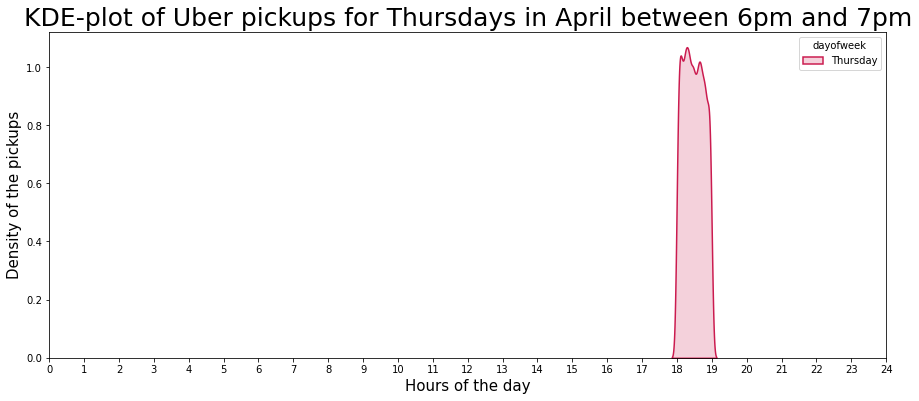

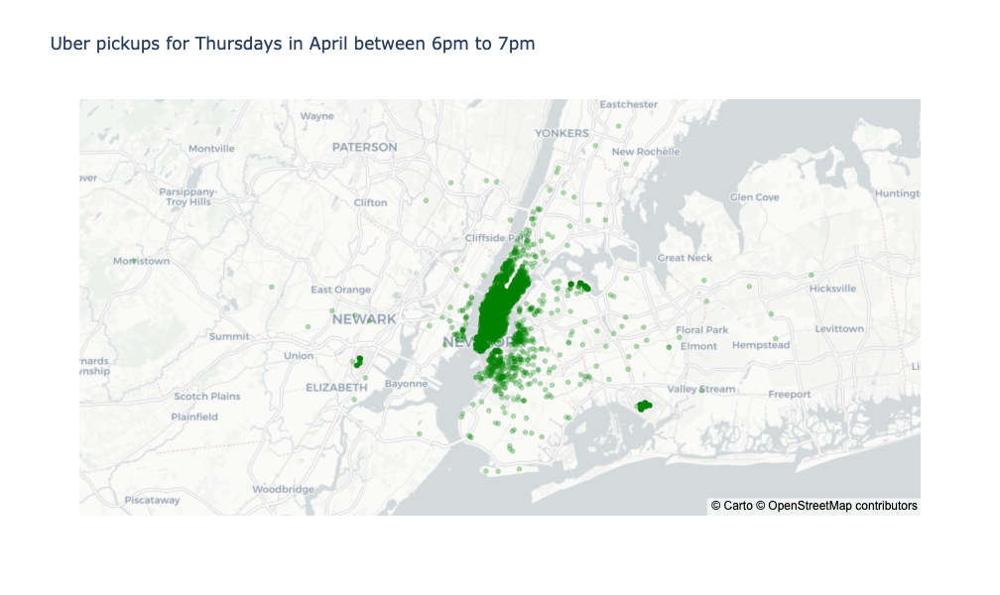

In [12]:
# now lets only keep Thursdays between 6pm and 7pm
mask = (df_apr_2014.loc[: , 'hour'] == 18) & (df_apr_2014.loc[: , 'dayofweek'] == 'Thursday')

df_apr14_Th_6pm = df_apr_2014.loc[mask]

print("Unique values for hour of the day: ", df_apr14_Th_6pm['hour'].value_counts())
print("Unique values for day of the week: ", df_apr14_Th_6pm['dayofweek'].value_counts())

plt.figure(figsize=(15, 6))
ax = sns.kdeplot(data = df_apr14_Th_6pm, x = 'timeofday', hue = 'dayofweek', palette = 'rocket', alpha = 0.2, linewidth = 1.5, fill = True)
ax.set_title('KDE-plot of Uber pickups for Thursdays in April between 6pm and 7pm', fontsize = 25)
ax.set_xlabel('Hours of the day', fontsize = 15)
ax.set_ylabel('Density of the pickups', fontsize = 15)
ax.set_xticks([i for i in range(25)])

fig = px.scatter_mapbox(df_apr14_Th_6pm, lat = 'Lat', lon = 'Lon', \
                        mapbox_style='carto-positron', \
                        opacity = 0.3, color_discrete_sequence=['green'], \
                        width=900, height=600, zoom=9,\
                        title = 'Uber pickups for Thursdays in April between 6pm to 7pm', 
                        center = {'lat' : df_apr14_Th_6pm['Lat'].median(), 'lon' : df_apr14_Th_6pm['Lon'].median()}
                       )



plt.show(), fig.show()

del df_apr_2014

<font size = 5>
- Well it looks like we are playing with the right set of data <br>
- The scatter mapbow shows where to expect clusters with DBSCAN (airports, manhattan, brooklyn, williamsburg, maybe newport)

### <ins>Preprocessing of the data for clustering</ins>

In [13]:
#Normalization of the geographical data
print('Dataset before normalization:\n')
display(df_apr14_Th_6pm[['Lat', 'Lon']].head())
print()

X = df_apr14_Th_6pm[['Lat', 'Lon']]
sc = StandardScaler()
X = sc.fit_transform(X)
print('Dataset after normalization:\n')
print(X[ :5, ])

Dataset before normalization:



,Lat,Lon
3240,40.7135,-73.9655
3241,40.7647,-73.9717
3242,40.7731,-73.8854
3243,40.7551,-73.9689
3244,40.7409,-73.9877



Dataset after normalization:

[[-0.95722085  0.28121197]
 [ 0.71251001  0.14394872]
 [ 0.98645022  2.05456463]
 [ 0.39943547  0.20593858]
 [-0.06365395 -0.21027903]]


### <ins>K-Means clustering</ins>

In [14]:
# find the optimum number of clusters for our problem with elbow and silouhette
wcss =  []
sil = []
k = []

for i in range (2,15): 
    kmeans = KMeans(n_clusters= i, init = "k-means++", random_state = 0)
    kmeans.fit(X)
    wcss.append(kmeans.inertia_)
    sil.append(silhouette_score(X, kmeans.predict(X)))
    k.append(i)
    print("For K = {} : WCSS score = {} // Silouhette score = {}".format(i, wcss[-1], sil[-1]))

For K = 2 : WCSS score = 9297.139551450771 // Silouhette score = 0.6937721973807905
For K = 3 : WCSS score = 6363.954668369433 // Silouhette score = 0.5012245301558083
For K = 4 : WCSS score = 4707.029513921068 // Silouhette score = 0.5277245118473535
For K = 5 : WCSS score = 3756.691755877233 // Silouhette score = 0.5325391576251026
For K = 6 : WCSS score = 3095.6067613798123 // Silouhette score = 0.5208737655405885
For K = 7 : WCSS score = 2522.4619323502016 // Silouhette score = 0.524348361753146
For K = 8 : WCSS score = 2083.878445951013 // Silouhette score = 0.4964573877170223
For K = 9 : WCSS score = 1751.989323830214 // Silouhette score = 0.49635915423762617
For K = 10 : WCSS score = 1477.866697988823 // Silouhette score = 0.45769814288053035
For K = 11 : WCSS score = 1321.3308113622993 // Silouhette score = 0.4591266377932689
For K = 12 : WCSS score = 1191.9838492938734 // Silouhette score = 0.4613070588699743
For K = 13 : WCSS score = 1071.6455608211063 // Silouhette score = 0

In [15]:
#Save data in case we want to come back to it
k_means_dict = {'k_clusters':k, 'sil_score':sil, 'wcss':wcss}
k_means_data = pd.DataFrame(k_means_dict)
k_means_data.to_csv("datas/kmeans_sil_wcss_apr14_Th_6pm.csv")

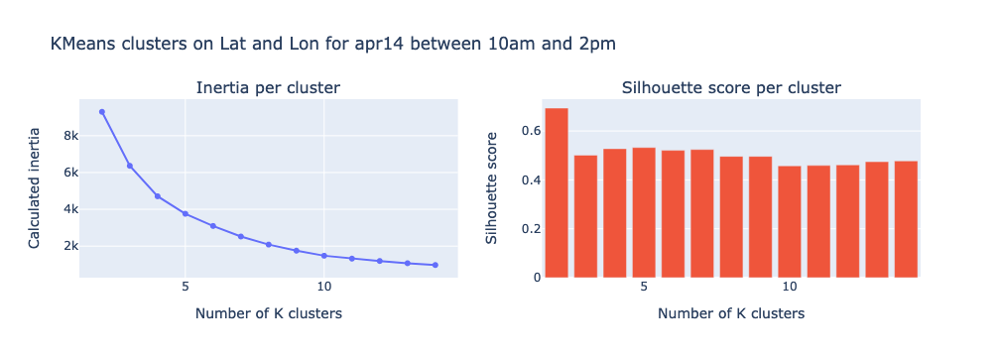

In [16]:
# Let's visualize inertia and silhouette scores
# Create DataFrame
wcss_frame = k_means_data.loc[ : , 'wcss']
cluster_scores = k_means_data.loc[ : , 'sil_score']
k_frame = k_means_data.loc[ : , 'k_clusters']

fig = make_subplots(rows=1, 
                    cols=2, 
                    subplot_titles=("Inertia per cluster", "Silhouette score per cluster",)
                   )


# Create inertia figure
fig.add_trace(go.Scatter(
    x=k_frame,
    y=wcss_frame), 
    row = 1, col = 1,
)


# Create silouhette figure
fig.add_trace(go.Bar(  
            x=k, 
            y=cluster_scores), 
            row = 1, col = 2
            )

fig.update_layout(title_text="KMeans clusters on Lat and Lon for apr14 between 10am and 2pm", showlegend = False)
fig.update_xaxes(title_text="Number of K clusters", row=1, col=1)
fig.update_yaxes(title_text="Calculated inertia", row=1, col=1)

fig.update_xaxes(title_text="Number of K clusters", row=1, col=2)
fig.update_yaxes(title_text="Silhouette score", row=1, col=2)

fig.show()

<font size = 5>
- Looks like K=5 could be a good number of clusters for that dataset<br>
- K=2 gets the highest silhouette score but splitting only in two, knowing what we do about the data does not make sens<br>
- Lets try the different K-clusters to see how KMeans behaves.

In [17]:
#Instantiate KMeans with different number of clusters. Don't forget to set random state for comparison purposes
K4 = KMeans(n_clusters=4, init = "k-means++", random_state = 0)
K5 = KMeans(n_clusters=5, init = "k-means++", random_state = 0)
K6 = KMeans(n_clusters=6, init = "k-means++", random_state = 0)
K7 = KMeans(n_clusters=7, init = "k-means++", random_state = 0)

kmeans = [K4, K5, K6, K7]

#Fit all the KMeans
for k in kmeans:
    k.fit(X)
    df_apr14_Th_6pm.loc[ : , ['K'+str(k.n_clusters)]] = k.labels_

In [18]:
display(df_apr14_Th_6pm.head())

,Date/Time,Lat,Lon,Base,hour,minutes,timeofday,dayofweek,dayofmonth,month,K4,K5,K6,K7
3240,2014-04-03 18:01:00,40.7135,-73.9655,B02512,18,1,18.016667,Thursday,3,April,0,2,4,4
3241,2014-04-03 18:01:00,40.7647,-73.9717,B02512,18,1,18.016667,Thursday,3,April,3,0,1,1
3242,2014-04-03 18:01:00,40.7731,-73.8854,B02512,18,1,18.016667,Thursday,3,April,1,3,5,5
3243,2014-04-03 18:01:00,40.7551,-73.9689,B02512,18,1,18.016667,Thursday,3,April,3,0,1,1
3244,2014-04-03 18:02:00,40.7409,-73.9877,B02512,18,2,18.033333,Thursday,3,April,3,0,4,4


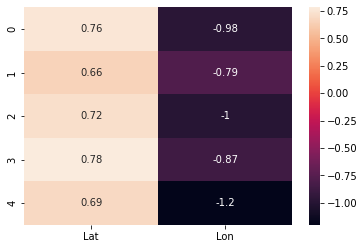

In [19]:
# Cluster centers coordinates
# Let's use inverse transform to have the real coordinates 
cluster_centers = sc.inverse_transform(K5.cluster_centers_)
cluster_centers = cluster_centers - np.array([40, -73]) #to rescale the cluster centroids, not really necessary

# Let's get column names to facilita understanding 
labels = ['Lat', 'Lon']

# Create a heatmap 
sns.heatmap(pd.DataFrame(cluster_centers, columns=labels),  annot=True)
plt.show()

<font size = 5>
- Not very informative...won't show the others</font>

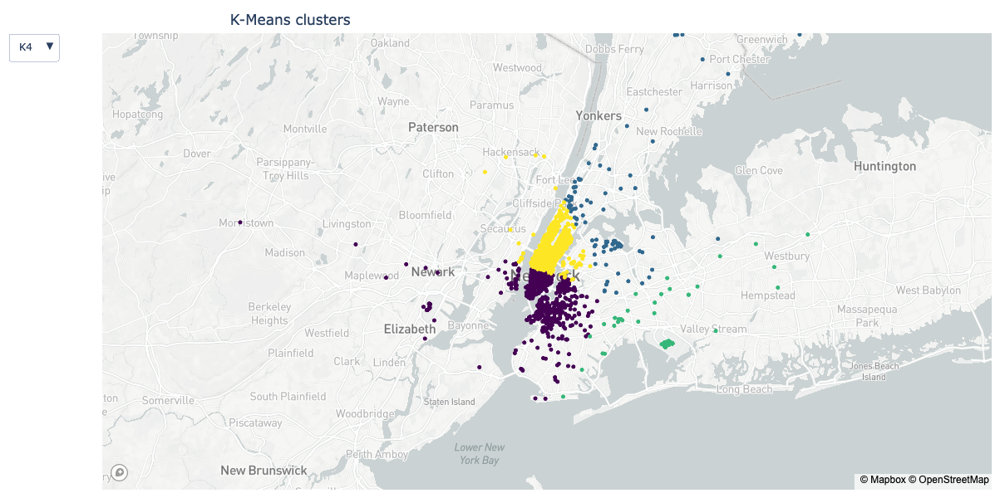

In [20]:
#Plot the scatter map of the K-Means clusters
fig = map_clusters(df = df_apr14_Th_6pm, \
                    lat_col = 'Lat', \
                    lon_col = 'Lon', \
                    k_cols = [k for k in df_apr14_Th_6pm.columns if k[0]=='K'], \
                    title = 'K-Means clusters', \
                    access_token = mapbox_access_token)

fig.show()

<font size = 5>
- KMeans fails to provide valuable information about the pickup locations.<br>
- It only clusters points based on there distance and generates as many cluster as asked for.<br>

### <ins>DBSCAN clustering</ins>
* Density-Based Spatial Clustering of Applications with Noise

In [21]:
# trying to find the optimal parameter for Epsilon
n_neigh = [20]
metric = ['manhattan', 'euclidean']
fig = go.Figure()

for m in metric:
    for n in n_neigh:
        neighbors = NearestNeighbors(n_neighbors=n, metric = m)
        neighbors_fit = neighbors.fit(X)
        distances, indices = neighbors_fit.kneighbors(X)

        distances = np.sort(distances, axis=0)
        distances = distances[:,1]

        x = [i for i in range(len(distances))]
        fig.add_trace(go.Scatter(x = x, y = distances, mode = 'lines', name = m.title()))


 
  

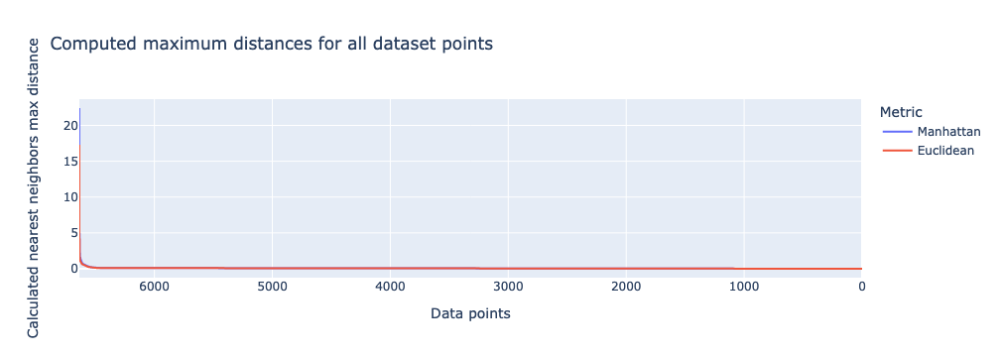

In [22]:
fig.update_layout(
            title = go.layout.Title(text = 'Computed maximum distances for all dataset points', xanchor = 'left'),
            legend_title_text='Metric',
            showlegend = True)
fig.update_xaxes(title_text="Data points", autorange = 'reversed')
fig.update_yaxes(title_text="Calculated nearest neighbors max distance")
fig.show()

<font size = 5>
- The optimal value depends on the metric used for clustering <br>
- The optimal Epsilon for DBSCAN clustering is somewhere between 0.2 and 0.7</font>

In [23]:
#Hyperparameters to test
eps = [0.05, 0.10, 0.15, 0.20, 0.25] #range of values that will be tested for Epsilon
min_spl = [10, 20, 30, 40, 50] #range of values that will be tested for min sample
metric = ['euclidean', 'manhattan'] #metrics used for distance calculation

#Initialize a dictionary that will hold the data
metrics = {'col_name' : [], \
           'eps' : [], \
           'min_spl' : [], \
           'metric' : [], \
           'n_clust' : [], \
           'db_score' : [], \
           'sil_score' : []
          }

counter = 1 #initialize the counter

for m in metric:

    clear_output() # just to clear output between the loops

    print("********** Started for {} metric **********".format(m))
    for e in eps:
        for ms in min_spl:        

            clustering = DBSCAN(eps = e, min_samples = ms, metric = m).fit(X)

            mask = clustering.labels_ != -1 #select labels without outliers
            n_labels = np.unique(clustering.labels_) #count the number of unique clusters found by DBSCAN
            col_name = str(m) + "-" + str(e) + "-" + str(ms)
            if len(n_labels) > 4: # only keep conditions yielding more than 4 clusters including the outliers
                
                db_score = davies_bouldin_score(X[mask], clustering.labels_[mask])
                # average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances
                # varies between 0 and infinity, 0 being best
                # internal validation method
                
                sil_score = silhouette_score(X[mask], clustering.labels_[mask], metric = m)

                df_apr14_Th_6pm.loc[: , col_name] = clustering.labels_
                metrics['col_name'].append(col_name)
                metrics['eps'].append(e)   
                metrics['min_spl'].append(ms)
                metrics['metric'].append(m)
                metrics['n_clust'].append((len(n_labels)))
                metrics['db_score'].append(db_score)
                metrics['sil_score'].append(sil_score)

        
            counter += 1
        print("completed for eps = {}".format(e))
    print("********** Ended for {} metric **********\n".format(m))

print("********** Process finished **********")
    
df_metrics_apr14_Th_6pm = pd.DataFrame(metrics)


********** Started for manhattan metric **********
completed for eps = 0.05
completed for eps = 0.1
completed for eps = 0.15
completed for eps = 0.2
completed for eps = 0.25
********** Ended for manhattan metric **********

********** Process finished **********


In [24]:
# save dataframes in case
df_metrics_apr14_Th_6pm.to_csv("datas/df_metrics_apr14_Th_6pm.csv")
df_apr14_Th_6pm.to_csv("datas/df_apr14_Th_6pm.csv")

In [25]:
# lets see how many conditions yielded more than 4 clusters per metric
print("Nb of Manhattan conditions yielding more than 4 clusters: ", len([k for k in df_apr14_Th_6pm if (k[:3] == 'man')]))
print("Nb of Euclidean conditions yielding more than 4 clusters: ", len([k for k in df_apr14_Th_6pm if (k[:3] == 'euc')]))

Nb of Manhattan conditions yielding more than 4 clusters:  25
Nb of Euclidean conditions yielding more than 4 clusters:  24


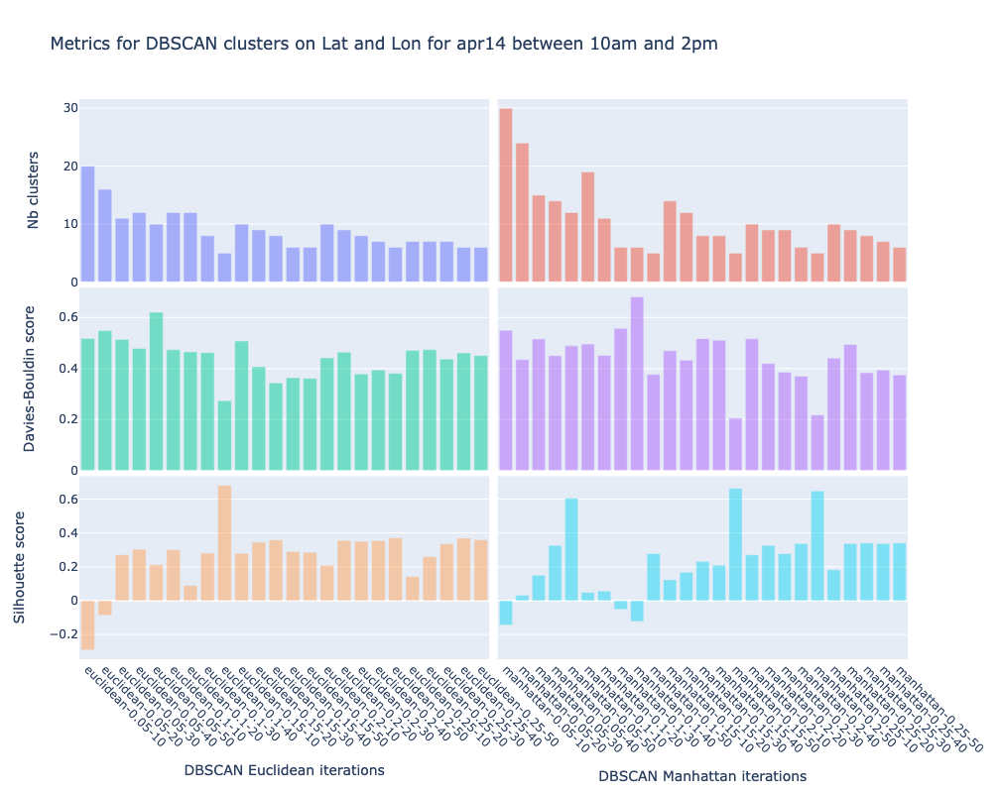

In [26]:
# let's visualize davies_bouldin_score and silhouette scores for DBSACN

fig = make_subplots(rows=3, 
                    cols=2,
                    shared_xaxes=True,
                    shared_yaxes=True,
                    vertical_spacing=0.01,
                    horizontal_spacing=0.01

                   )

#prepare data for euclidean metric
mask_1 = df_metrics_apr14_Th_6pm['metric'] == 'euclidean'
x_euc = df_metrics_apr14_Th_6pm.loc[mask_1]['col_name']
y_clust_euc = df_metrics_apr14_Th_6pm.loc[mask_1]['n_clust']
y_db_euc = df_metrics_apr14_Th_6pm.loc[mask_1]['db_score']
y_sil_euc = df_metrics_apr14_Th_6pm.loc[mask_1]['sil_score']

#prepare data for manhattan metric
mask_2 = df_metrics_apr14_Th_6pm['metric'] == 'manhattan'
x_man = df_metrics_apr14_Th_6pm.loc[mask_2]['col_name']
y_clust_man = df_metrics_apr14_Th_6pm.loc[mask_2]['n_clust']
y_db_man = df_metrics_apr14_Th_6pm.loc[mask_2]['db_score']
y_sil_man = df_metrics_apr14_Th_6pm.loc[mask_2]['sil_score']

# Create nb_cluster figures
fig.add_trace(go.Bar(
    x=x_euc,
    y=y_clust_euc,
    opacity = 0.5), 
    row = 1, col = 1,
)

fig.add_trace(go.Bar(
    x=x_man,
    y=y_clust_man,
    opacity=0.5), 
    row = 1, col = 2,
)



# Create davis_bouldin_score figures
fig.add_trace(go.Bar(
    x=x_euc,
    y=y_db_euc,
    opacity=0.5), 
    row = 2, col = 1,
)

fig.add_trace(go.Bar(
    x=x_man,
    y=y_db_man,
    opacity=0.5), 
    row = 2, col = 2,
)

# Create silhouette score figures
fig.add_trace(go.Bar(
    x=x_euc,
    y=y_sil_euc,
    opacity=0.5), 
    row = 3, col = 1,
)

fig.add_trace(go.Bar(
    x=x_man,
    y=y_sil_man,
    opacity=0.5), 
    row = 3, col = 2,
)

fig.update_layout(height=800, width=1000, title_text="Metrics for DBSCAN clusters on Lat and Lon for apr14 between 10am and 2pm", showlegend = False)

#Update y-axis titles for each subplot row
fig.update_yaxes(title_text="Nb clusters", row=1, col=1)
fig.update_yaxes(title_text="Davies-Bouldin score", row=2, col=1)
fig.update_yaxes(title_text="Silhouette score", row=3, col=1)

#update x-axis titles for each subplot columns
fig.update_xaxes(title_text="DBSCAN Euclidean iterations", row=3, col=1)
fig.update_xaxes(title_text="DBSCAN Manhattan iterations", row=3, col=2)
fig.update_xaxes(tickangle=45)

fig.show()

<font size = 5>In theory the best condition:<br>
*   maximizes the Silhouette score, <br>
*   minimizes the Davies-Bouldin score and <br>
*   produces a meaningful number of clusters <br> 

</font>


In [27]:
#The best clustering should produce a high silhouette score and a low Davies-Bouldhin score.
#Lets find out which parameters produce those scores and if they give meaning to the data

mask = df_metrics_apr14_Th_6pm['sil_score'] == df_metrics_apr14_Th_6pm['sil_score'].max()
print("Parameters giving the highest silhouette score:")
display(df_metrics_apr14_Th_6pm.loc[mask])

mask = df_metrics_apr14_Th_6pm['db_score'] == df_metrics_apr14_Th_6pm['db_score'].min()
print("Parameters giving the lowest Davies-Bouldhin score:")
display(df_metrics_apr14_Th_6pm.loc[mask])

Parameters giving the highest silhouette score:


,col_name,eps,min_spl,metric,n_clust,db_score,sil_score
8,euclidean-0.1-40,0.1,40,euclidean,5,0.273899,0.680962


Parameters giving the lowest Davies-Bouldhin score:


,col_name,eps,min_spl,metric,n_clust,db_score,sil_score
38,manhattan-0.15-50,0.15,50,manhattan,5,0.205573,0.663293


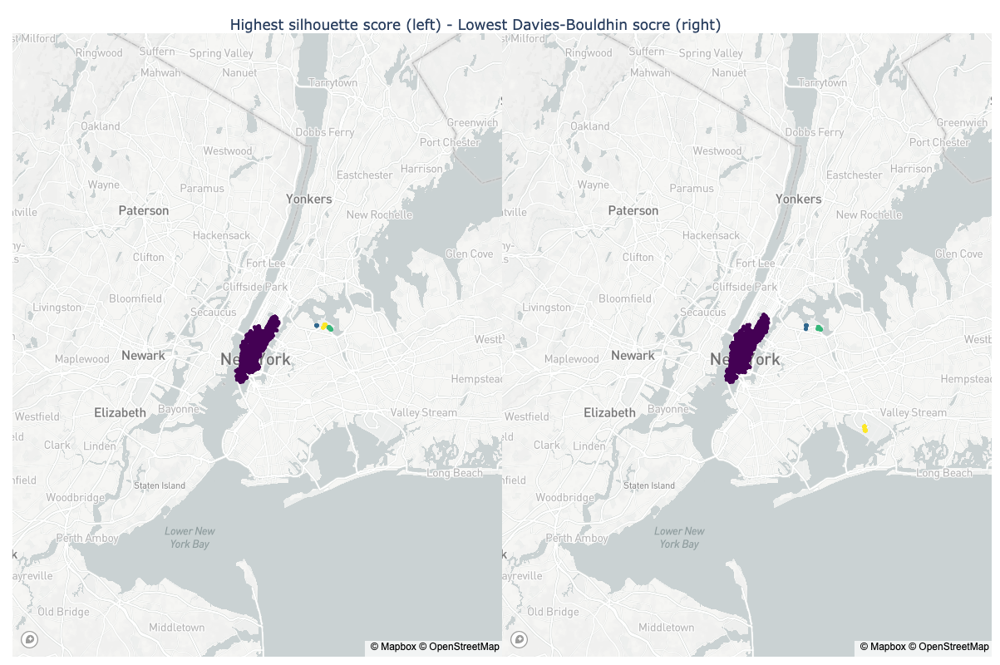

In [28]:

# lets plot the scatter mapbowes for those parameters using our plotting function

k_cols = ['euclidean-0.1-40', 'manhattan-0.15-50']
fig = subplot_clusters(df_apr14_Th_6pm,  'Lat', 'Lon', k_cols, mapbox_access_token, "Highest silhouette score (left) - Lowest Davies-Bouldhin socre (right)", nb_cols = 2, width=1200, height=800, zoom=9)
#fig.write_html("../cluster_maps/{}.html".format(params))
fig.show()

<font size = 5>
- At that time of day Uber pickups are most frequent around JFK and in Manhattan for those parameters. <br>
- It looks though as like we could do better considering what we know. <br>
- Lets see if there is another set of parameters that would do better.


In [29]:
#Generate plots for euclidean and manhattant with the epsilons listed bellow and save them as html not to crash the notebook
params_list = ["-{}-".format(str(x)) for x in df_metrics_apr14_Th_6pm['eps'].unique()]
for params in params_list:
    k_cols = [col for col in df_apr14_Th_6pm if params in col]
    fig = subplot_clusters(df_apr14_Th_6pm, 'Lat', 'Lon', k_cols, mapbox_access_token, 'Epsilon: {}'.format(params), frac=0.4, nb_cols=4, width=1000, height=1000, zoom=8)
    fig.write_html("cluster_maps/{}.html".format(params)) #saved to html files directly

#Generate plots for euclidean and manhattant with the minimum sample sizes listed bellow and save them as html not to crash the notebook
params_list = ["-{}".format(str(x)) for x in df_metrics_apr14_Th_6pm['min_spl'].unique()]
for params in params_list:
    k_cols = [col for col in df_apr14_Th_6pm if params in col]
    fig = subplot_clusters(df_apr14_Th_6pm, 'Lat', 'Lon', k_cols, mapbox_access_token, "Min sample size: {}".format(params), frac=0.4, nb_cols=4, width=1800, height=1000, zoom=8)
    fig.write_html("cluster_maps/{}.html".format(params)) #saved to html files directly

<font size = 5>
- After review of the data DBSCAN clustering with the Manhattan metric, an epsilon of 0.2 and a minimum sample size of 10 produces meaningful data</font>

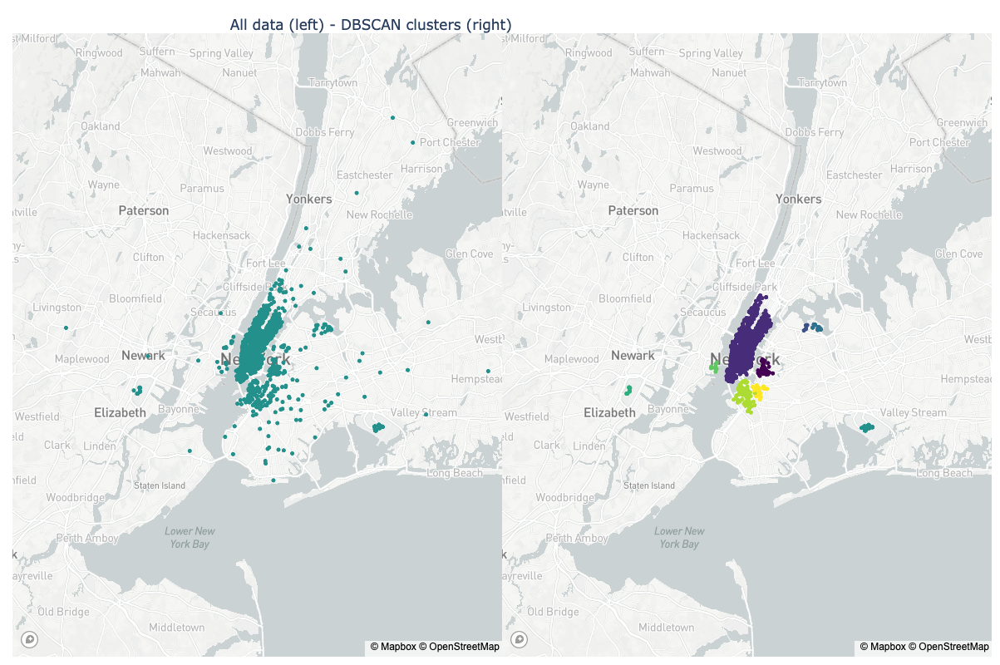

In [30]:

k_cols = ['hour', 'manhattan-0.2-10']
fig = subplot_clusters(df_apr14_Th_6pm,  'Lat', 'Lon', k_cols, mapbox_access_token, "All data (left) - DBSCAN clusters (right)", nb_cols = 2, width=1200, height=800, zoom=9)
#fig.write_html("../cluster_maps/{}.html".format(params))
fig.show()

## Part III: Generalize the approach to cluster for all months, days and hours per day

In [32]:
months_short = ['apr14', 'may14', 'jun14', 'jul14', 'aug14', 'sep14']
months_full = ['April', 'May', 'June', 'July', 'August', 'September']
month_translate = {short:long for short, long in zip(months_short, months_full)}

total_size = 0 #initialize a counter to count the number of rows processed

for i, month in enumerate(months_short):

    dir = "datas/DBSCAN_month_day_hour/{}".format(month_translate[month])
    if os.path.exists(dir):
        shutil.rmtree(dir)

    os.mkdir(dir)


    #Load the dataset and add the necessary columns
    df = pd.read_csv("uber-trip-data/uber-raw-data-{}.csv".format(month), parse_dates=[0])
    df.loc[ : , 'hour'] = df.loc[ : , 'Date/Time'].apply(lambda x: x.strftime("%H"))
    df.loc[ : , 'dayofweek'] = df.loc[ : , 'Date/Time'].apply(lambda x: x.strftime("%A"))
    df.loc[ :, 'month'] = df['Date/Time'].apply(lambda x: x.strftime("%B"))

    clear_output()

    #Data standardization
    X = df[['Lat', 'Lon']].values
    X = sc.transform(X)

    if i == 0:
        temp_df = pd.DataFrame(columns = [col for col in df.columns] + ['db_clusters']) #initialize a dataframe to store all the data

    print("***** Dataset loaded and prepared for {} *****\n".format(month))

    hours = df['hour'].unique()
    daysofweek = df['dayofweek'].unique()

    for day in daysofweek: #loop over the days of the week for each month

        temp_day_df = pd.DataFrame(columns = [col for col in df.columns] + ['db_clusters']) #initialize a dataframe to store data per day in case needed

        for hour in hours: #loop over each hour for every day of each month

            mask = (df['hour'] == hour) & (df['dayofweek'] == day) #build a mask to downsample X according to the data being processed
            
            clustering = DBSCAN(eps = 0.20, min_samples = 10, metric = 'manhattan').fit(X[mask]) #perform DBSCAN clustering on the data

            datas = df.loc[mask]
            datas['db_clusters'] = clustering.labels_

            total_size += datas.shape[0] #count the total number of lines retrieved during the process

            temp_day_df = temp_day_df.append(datas, ignore_index=True)
        

        print("Number of rows for {} in the {} dataset: {}".format(day, month, df[df['dayofweek'] == day].shape[0]))
        print("Shape of obtained dataframe for {} in {}: {}".format(day, month, temp_day_df.shape))


        temp_day_df.to_csv(f"datas/DBSCAN_month_day_hour/{month_translate[month]}/{day}.csv".format(month, month, day))
        print("Data saved for {} in {}".format(day, month))


        temp_df = temp_df.append(temp_day_df, ignore_index=True)
                
    print("***** Process completed for {} *****\n".format(month))

clear_output()

print("***** The process has ended *****\n")

print("Expected total size of the final dataframe: {}".format(total_size))
print("Shape of the obtained dataframe: {}".format(temp_df.shape))

temp_df.to_csv("datas/DBSCAN_month_day_hour/db_clust_maysep14.csv")

print("Data has been saved")




        

***** The process has ended *****

Expected total size of the final dataframe: 4534327
Shape of the obtained dataframe: (4534327, 8)
Data has been saved


<font size = 5>
- Instead of clustering individually on each subsample of the dataframe, we might be able to use the `fit_predict` attribute of DBSCAN. <br>
- Maybe perform multi-feature clustering using `circularized`data for day and hours <br>